In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings as wn
Warning = wn.filterwarnings('ignore')
from scipy.stats import chi2_contingency, f_oneway
from scipy.stats import skew


1. **Data Cleaning and Preprocessing**:

In [2]:
import pandas as pd

# Load the dataset
df = 'loan.csv'
loan_data = pd.read_csv(df)

# Display the first few rows of the dataset
loan_data.head()


,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,...,num_tl_90g_dpd_24m,num_tl_op_past_12m,pct_tl_nvr_dlq,percent_bc_gt_75,pub_rec_bankruptcies,tax_liens,tot_hi_cred_lim,total_bal_ex_mort,total_bc_limit,total_il_high_credit_limit
0,1077501,1296599,5000,5000,4975.0,36 months,10.65%,162.87,B,B2,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
1,1077430,1314167,2500,2500,2500.0,60 months,15.27%,59.83,C,C4,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
2,1077175,1313524,2400,2400,2400.0,36 months,15.96%,84.33,C,C5,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
3,1076863,1277178,10000,10000,10000.0,36 months,13.49%,339.31,C,C1,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
4,1075358,1311748,3000,3000,3000.0,60 months,12.69%,67.79,B,B5,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN


1. Data Cleaning and Preprocessing

In [3]:
# Get an overview of the dataset's structure
loan_data.info()

# Check for missing values
missing_values = loan_data.isnull().sum().sort_values(ascending=False)

# Display the top 20 columns with the most missing values
missing_values.head(20)


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 39717 entries, 0 to 39716
Columns: 111 entries, id to total_il_high_credit_limit
dtypes: float64(74), int64(13), object(24)
memory usage: 33.6+ MB


verification_status_joint    39717
annual_inc_joint             39717
mo_sin_old_rev_tl_op         39717
mo_sin_old_il_acct           39717
bc_util                      39717
bc_open_to_buy               39717
avg_cur_bal                  39717
acc_open_past_24mths         39717
inq_last_12m                 39717
total_cu_tl                  39717
inq_fi                       39717
total_rev_hi_lim             39717
all_util                     39717
max_bal_bc                   39717
open_rv_24m                  39717
open_rv_12m                  39717
il_util                      39717
total_bal_il                 39717
mths_since_rcnt_il           39717
open_il_24m                  39717
dtype: int64

Observations:

The dataset has 39,717 entries and 111 columns.

A significant number of columns have missing values for all rows.

The dataset contains numerical and categorical variables.

In [4]:
# Step 1: Remove columns with more than 90% missing values
threshold = 0.9 * len(loan_data)
loan_data_reduced = loan_data.dropna(thresh=threshold, axis=1)

# Check the shape of the data after removing columns
loan_data_reduced.shape

# Step 2: Handle missing values in the remaining columns
# First, we'll get an updated list of missing values for the reduced dataset
missing_values_reduced = loan_data_reduced.isnull().sum().sort_values(ascending=False)

# Display the top 20 columns with the most missing values in the reduced dataset
missing_values_reduced.head(20)


emp_title                     2459
emp_length                    1075
pub_rec_bankruptcies           697
last_pymnt_d                    71
collections_12_mths_ex_med      56
chargeoff_within_12_mths        56
revol_util                      50
tax_liens                       39
title                           11
last_credit_pull_d               2
total_rec_prncp                  0
out_prncp                        0
initial_list_status              0
out_prncp_inv                    0
total_acc                        0
total_pymnt                      0
total_pymnt_inv                  0
collection_recovery_fee          0
total_rec_int                    0
total_rec_late_fee               0
dtype: int64

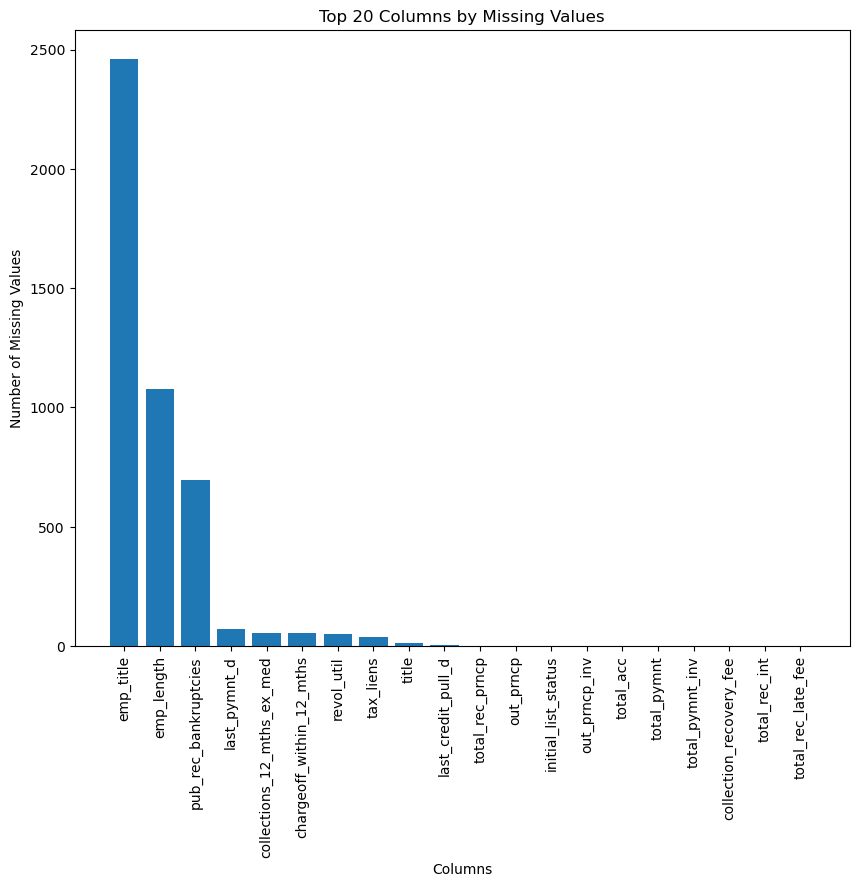

In [10]:
top_missing_values = missing_values_reduced.head(20)
plt.figure(figsize=(10, 8))  # Set the figure size
plt.bar(top_missing_values.index, top_missing_values)  # Create a bar chart
plt.xlabel('Columns')  # Set the x-label
plt.ylabel('Number of Missing Values')  # Set the y-label
plt.xticks(rotation=90)  # Rotate the x-axis labels for better readability
plt.title('Top 20 Columns by Missing Values')  # Set the title
plt.show()  # Display the plot

Observations:

After removing columns with more than 90% missing values, the dataset is reduced to a more manageable size.

The remaining columns still have some missing values, but not as excessively.

Key columns with missing values include emp_title, emp_length, pub_rec_bankruptcies, last_pymnt_d, and a few others.

In [5]:
from sklearn.preprocessing import LabelEncoder

# Step 1: Handle missing values
# Numerical columns - impute with median
numerical_cols = loan_data_reduced.select_dtypes(include=['float64', 'int64']).columns
loan_data_reduced[numerical_cols] = loan_data_reduced[numerical_cols].fillna(loan_data_reduced[numerical_cols].median())

# Categorical columns - impute with 'Unknown'
categorical_cols = loan_data_reduced.select_dtypes(include=['object']).columns
loan_data_reduced[categorical_cols] = loan_data_reduced[categorical_cols].fillna('Unknown')

# Step 2: Convert categorical variables to numerical representations
# Using LabelEncoder for simplicity, can also use OneHotEncoder if needed
label_encoders = {}
for col in categorical_cols:
    le = LabelEncoder()
    loan_data_reduced[col] = le.fit_transform(loan_data_reduced[col])
    label_encoders[col] = le

# Step 3: Check for outliers (we'll use the IQR method)
def remove_outliers(df, columns):
    for col in columns:
        Q1 = df[col].quantile(0.25)
        Q3 = df[col].quantile(0.75)
        IQR = Q3 - Q1
        df = df[(df[col] >= (Q1 - 1.5 * IQR)) & (df[col] <= (Q3 + 1.5 * IQR))]
    return df

# Remove outliers from numerical columns
loan_data_cleaned = remove_outliers(loan_data_reduced, numerical_cols)

# Check the shape of the cleaned data
loan_data_cleaned.shape


(17627, 53)

2. **Univariate Analysis**:
   


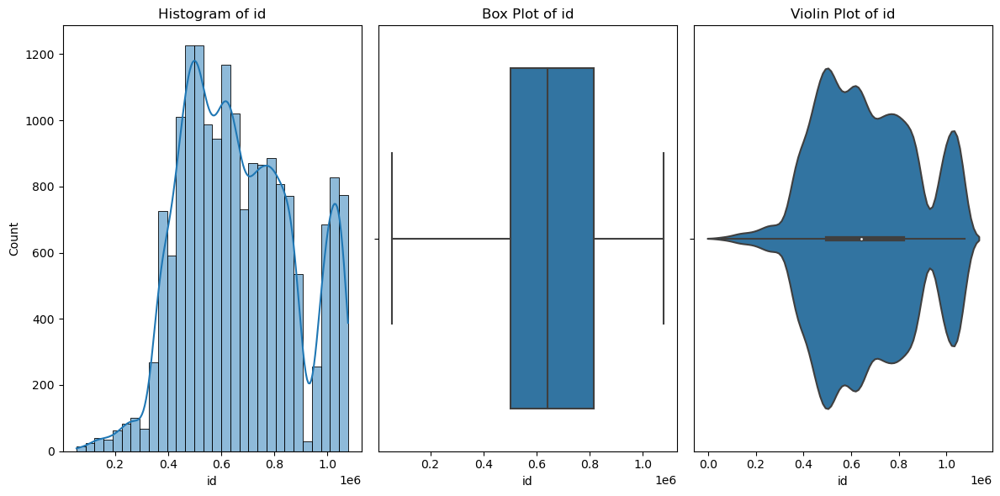

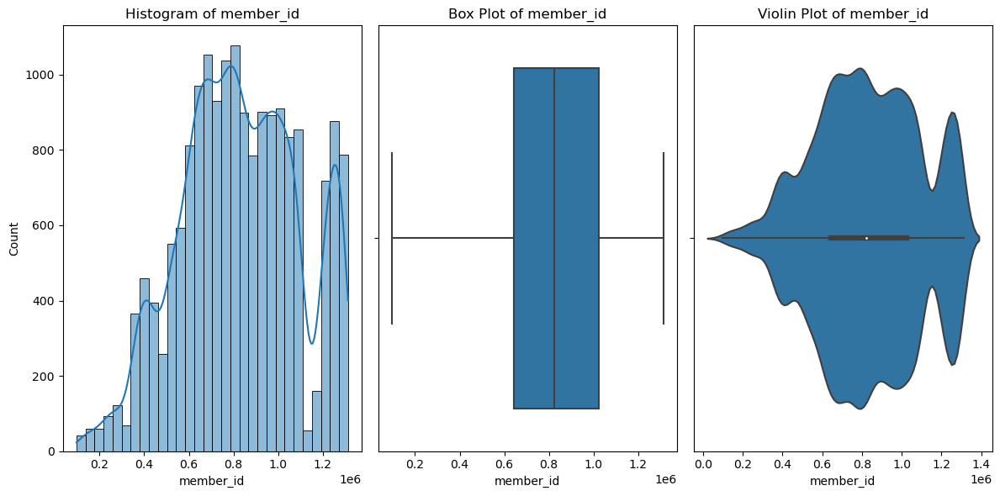

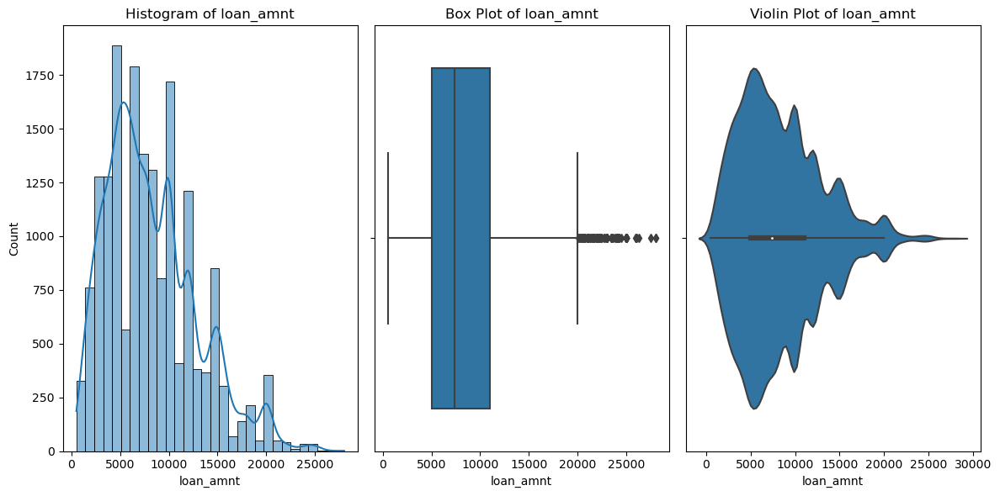

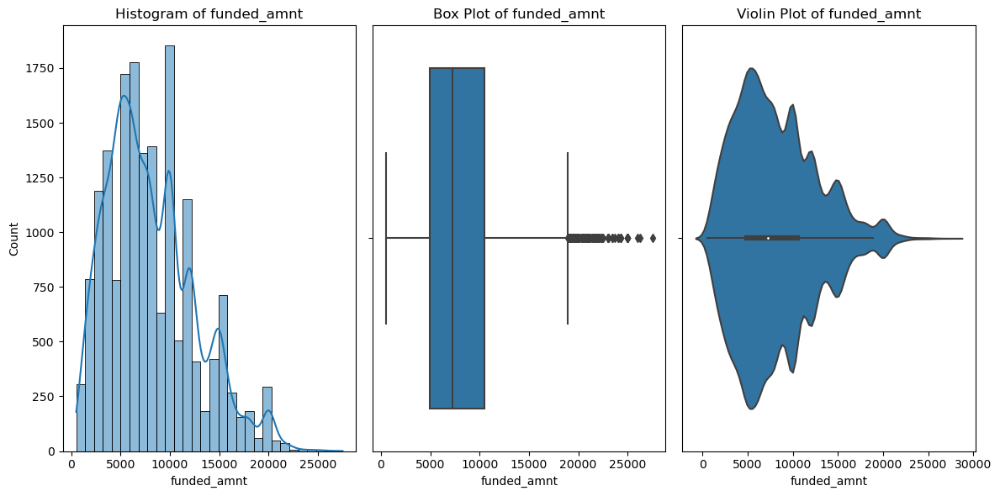

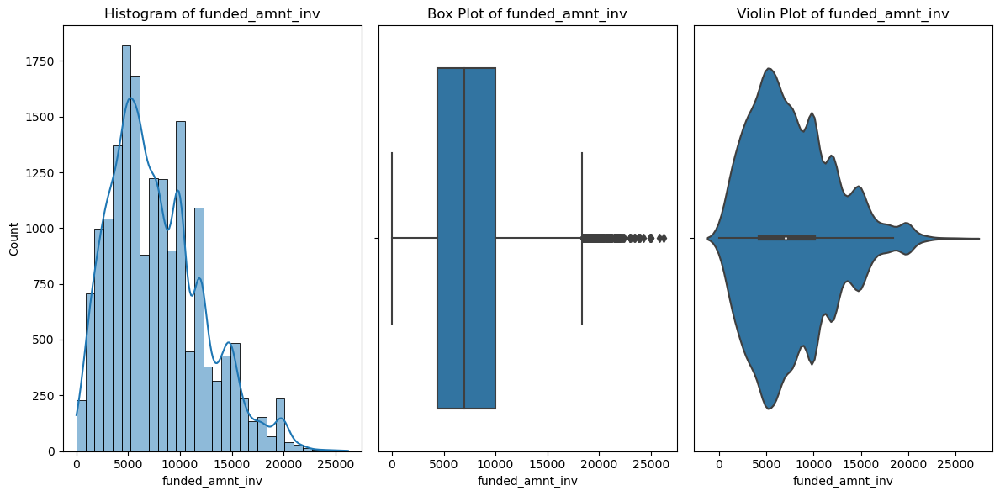

...

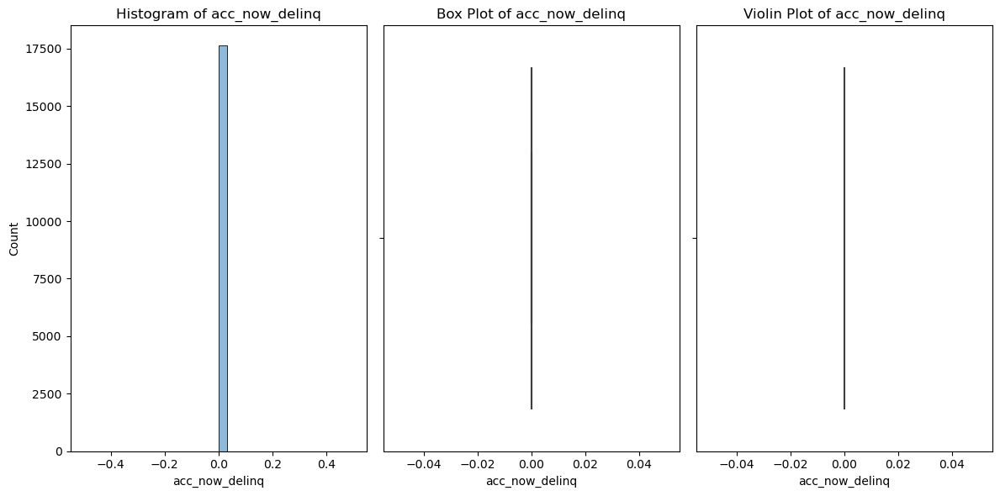

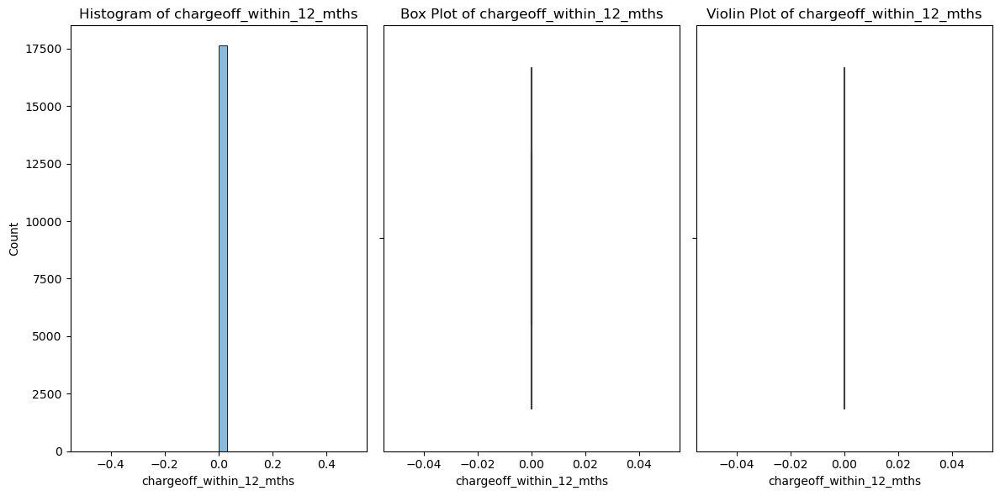

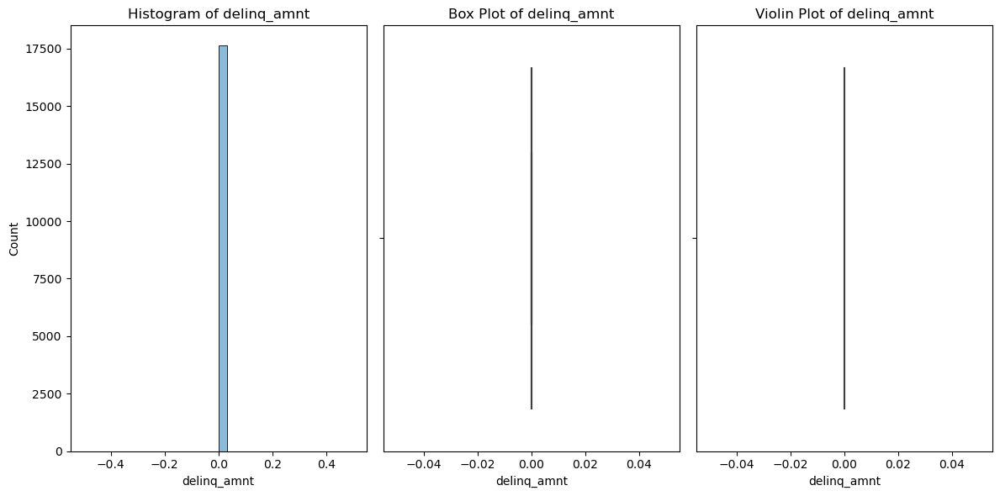

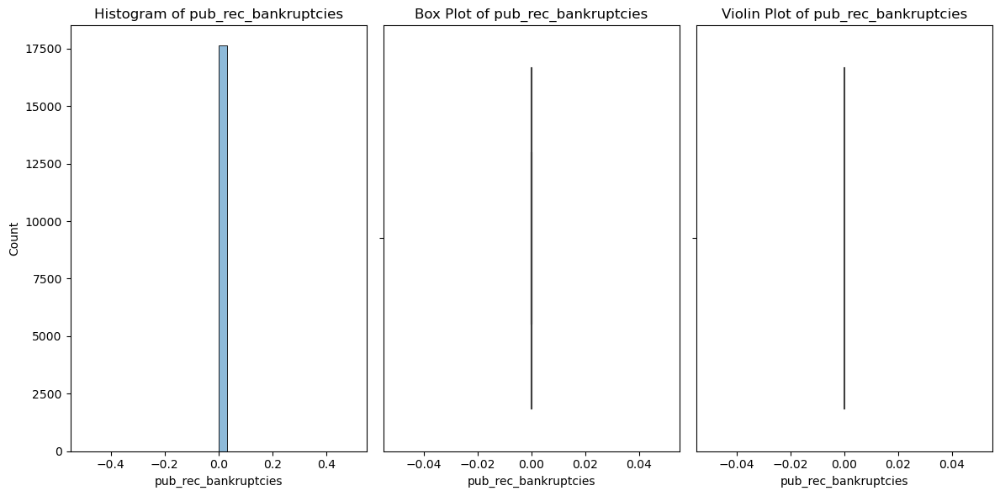

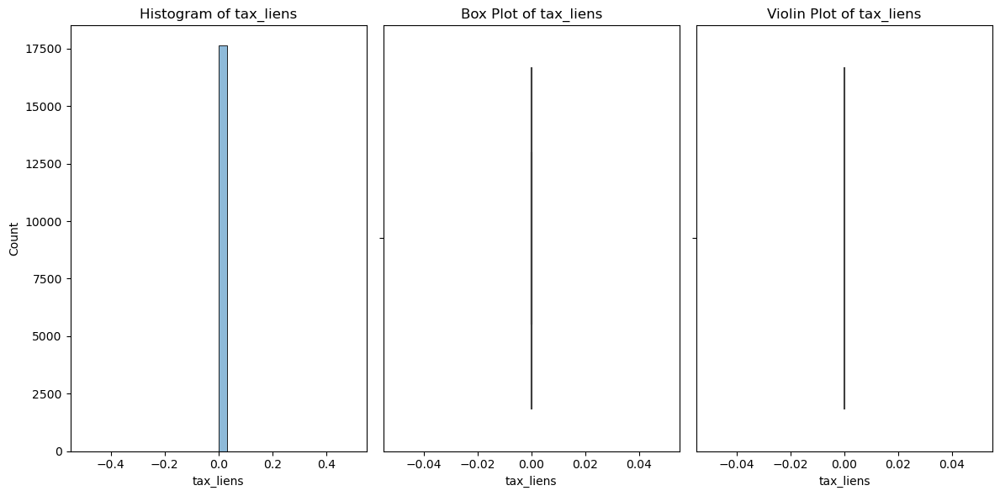

                              count           mean            std       min  \
id                          17627.0  667202.117604  208922.423837  55742.00   
member_id                   17627.0  830853.166336  264576.009973  96338.00   
loan_amnt                   17627.0    8216.008113    4637.544145    500.00   
funded_amnt                 17627.0    8061.188801    4446.569628    500.00   
funded_amnt_inv             17627.0    7681.714676    4414.047541      0.00   
installment                 17627.0     251.368271     143.050056     15.69   
annual_inc                  17627.0   54929.709335   25026.663015   4000.00   
dti                         17627.0      12.922737       6.736721      0.00   
delinq_2yrs                 17627.0       0.000000       0.000000      0.00   
inq_last_6mths              17627.0       0.589323       0.733536      0.00   
open_acc                    17627.0       8.353435       3.573864      2.00   
pub_rec                     17627.0       0.000000  

In [6]:

# List of numerical columns
numerical_cols = loan_data_cleaned.select_dtypes(include=['float64', 'int64']).columns

# Summary statistics for numerical features
summary_statistics = loan_data_cleaned[numerical_cols].describe().T
summary_statistics['skewness'] = loan_data_cleaned[numerical_cols].apply(lambda x: skew(x))

# Plotting distributions
for col in numerical_cols:
    plt.figure(figsize=(12, 6))

    # Histogram
    plt.subplot(1, 3, 1)
    sns.histplot(loan_data_cleaned[col], kde=True, bins=30)
    plt.title(f'Histogram of {col}')

    # Box Plot
    plt.subplot(1, 3, 2)
    sns.boxplot(x=loan_data_cleaned[col])
    plt.title(f'Box Plot of {col}')

    # Violin Plot
    plt.subplot(1, 3, 3)
    sns.violinplot(x=loan_data_cleaned[col])
    plt.title(f'Violin Plot of {col}')

    plt.tight_layout()
    plt.show()

# Display the summary statistics
print(summary_statistics)


3. **Bivariate Analysis**:
   

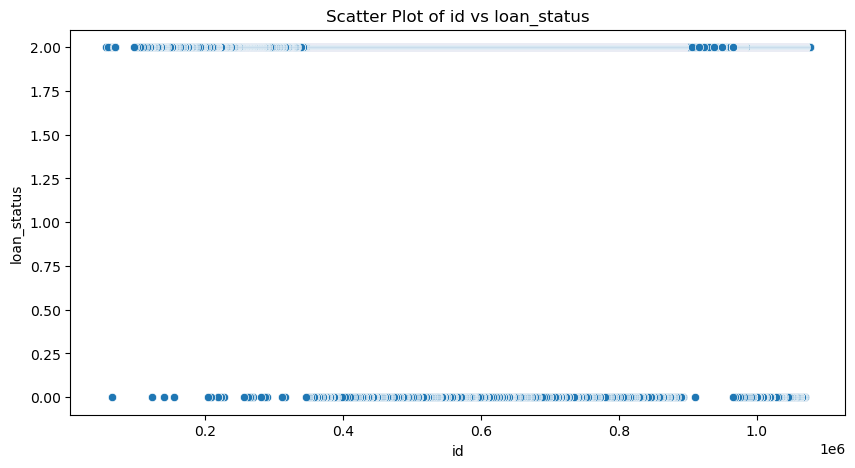

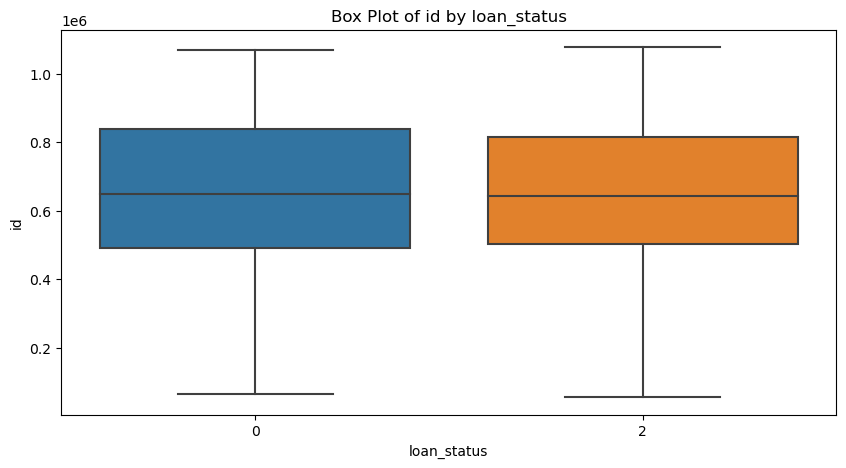

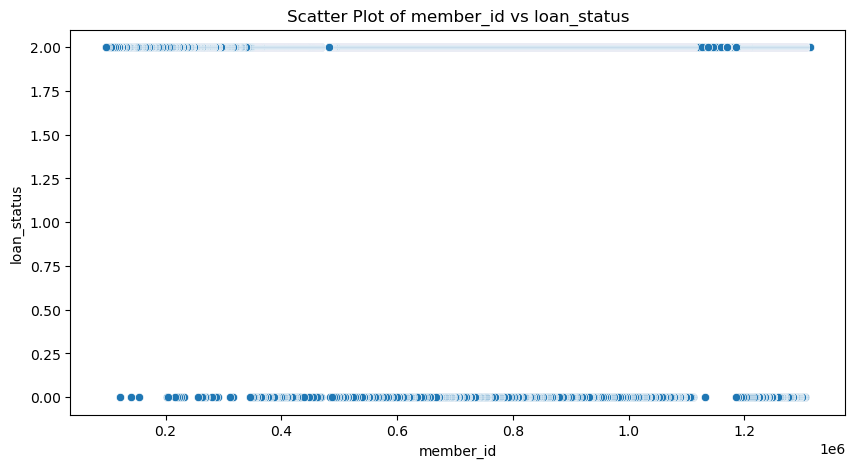

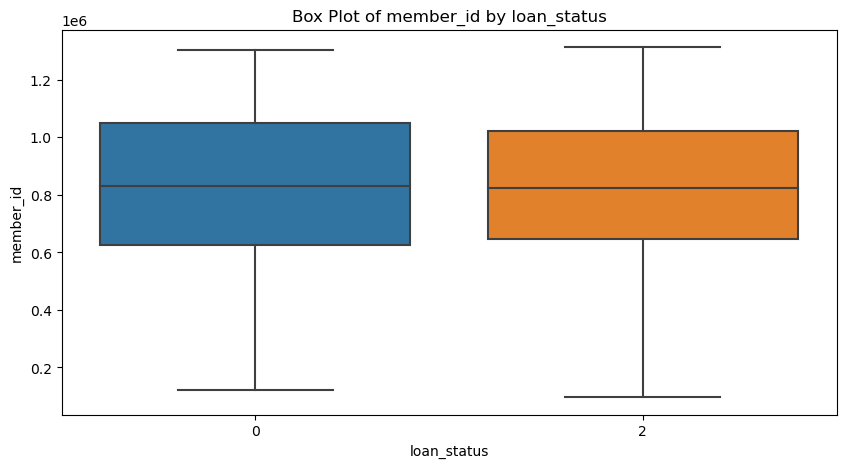

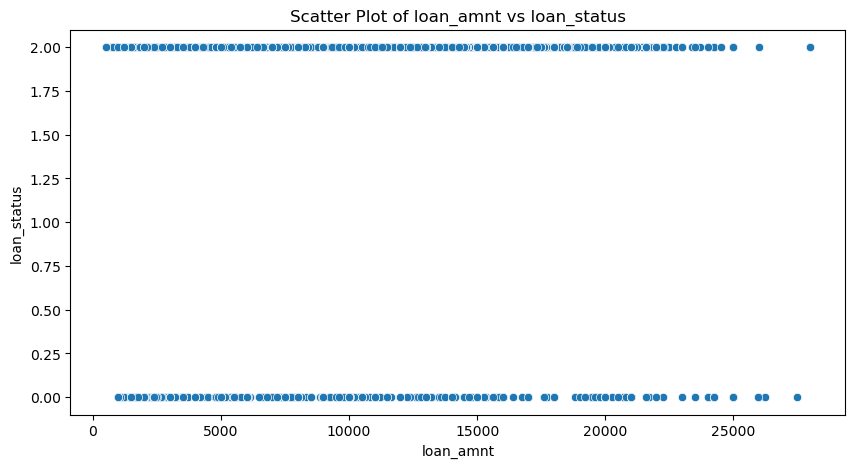

...

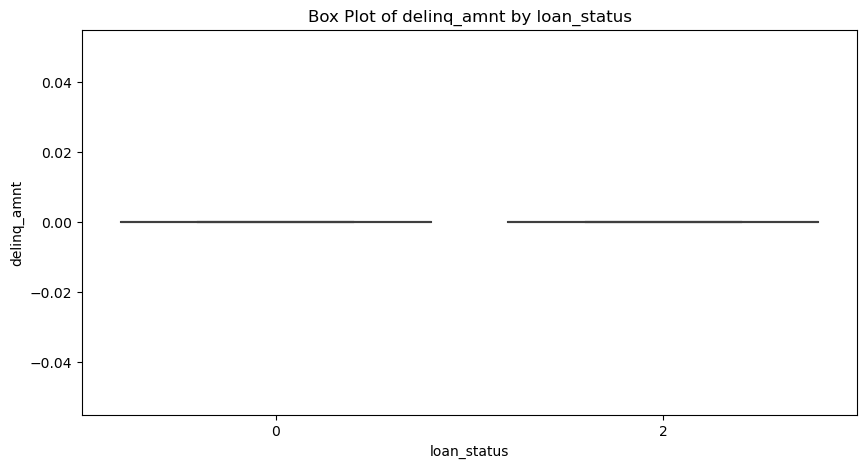

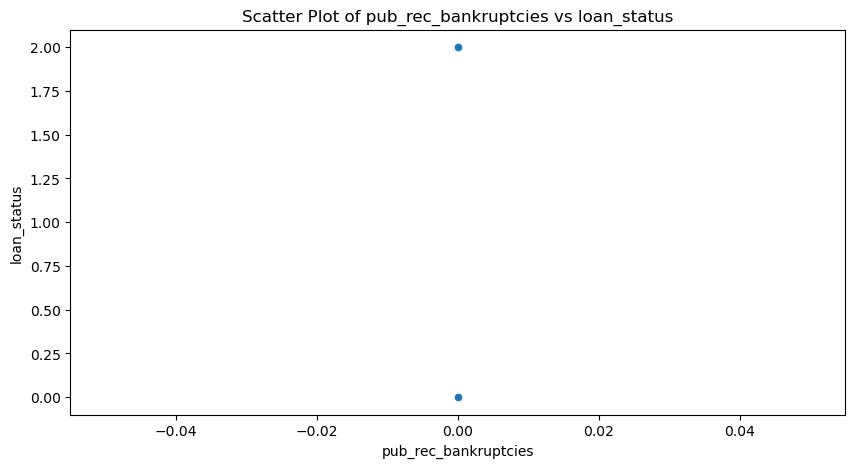

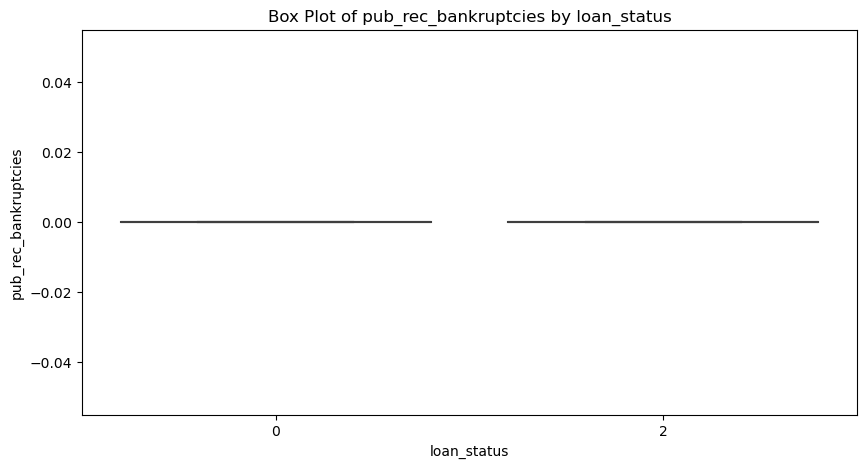

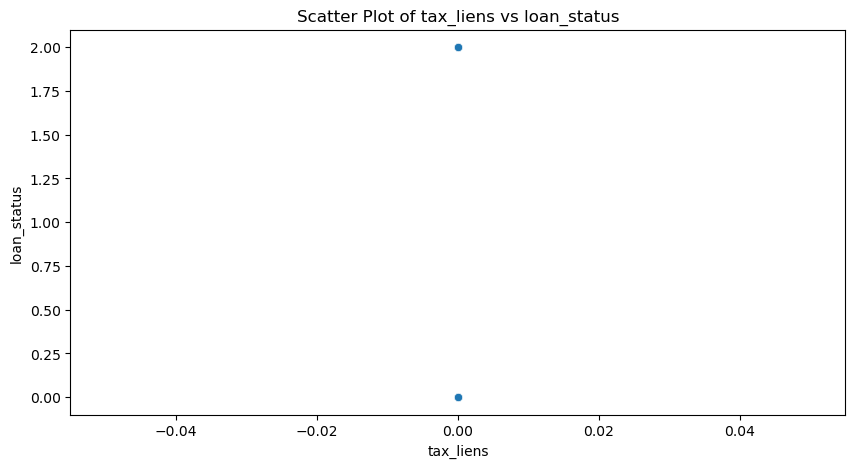

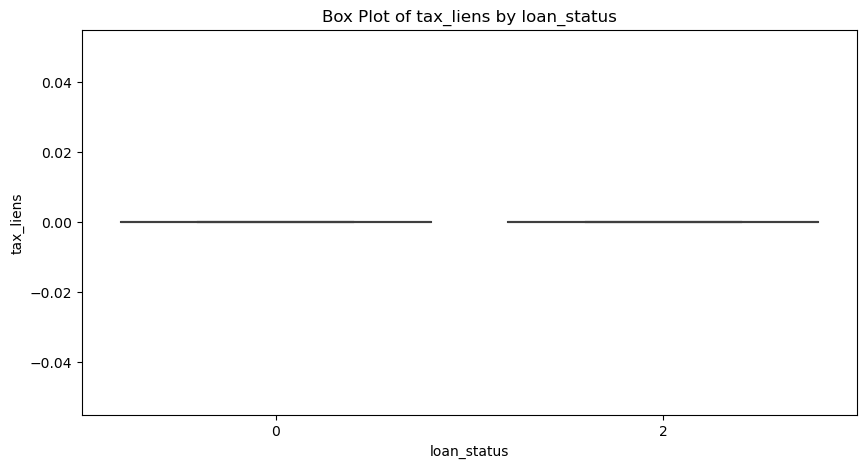

In [7]:
target_variable = 'loan_status'

# Convert the target variable to numerical if it's categorical
if loan_data_cleaned[target_variable].dtype == 'object':
    loan_data_cleaned[target_variable] = loan_data_cleaned[target_variable].astype('category').cat.codes

# List of numerical columns
numerical_cols = loan_data_cleaned.select_dtypes(include=['float64', 'int64']).columns
# List of categorical columns
categorical_cols = loan_data_cleaned.select_dtypes(include=['object']).columns

# 1. Visualizing relationships
for col in numerical_cols:
    if col != target_variable:
        plt.figure(figsize=(10, 5))
        sns.scatterplot(x=loan_data_cleaned[col], y=loan_data_cleaned[target_variable])
        plt.title(f'Scatter Plot of {col} vs {target_variable}')
        plt.show()

        plt.figure(figsize=(10, 5))
        sns.boxplot(x=loan_data_cleaned[target_variable], y=loan_data_cleaned[col])
        plt.title(f'Box Plot of {col} by {target_variable}')
        plt.show()

for col in categorical_cols:
    plt.figure(figsize=(10, 5))
    sns.countplot(x=loan_data_cleaned[col], hue=loan_data_cleaned[target_variable])
    plt.title(f'Bar Plot of {col} by {target_variable}')
    plt.xticks(rotation=90)
    plt.show()



In [9]:
from sklearn.preprocessing import LabelEncoder

# Initialize the LabelEncoder
label_encoder = LabelEncoder()

# Check if 'loan_status' is in the DataFrame and encode it
if 'loan_status' in loan_data_cleaned.columns:
    loan_data_cleaned['loan_status_encoded'] = label_encoder.fit_transform(loan_data_cleaned['loan_status'])

    # Ensure numerical_cols is a list
    numerical_cols = list(numerical_cols) if isinstance(numerical_cols, pd.Index) else numerical_cols

    # Append the new column name to your list of numerical columns
    numerical_cols.append('loan_status_encoded')

    # Now you can calculate the correlation matrix with the encoded 'loan_status'
    correlation_matrix = loan_data_cleaned[numerical_cols].corr()
    print(correlation_matrix)
else:
    print("Column 'loan_status' is not in the DataFrame.")

                                  id  member_id  loan_amnt  funded_amnt  \
id                          1.000000   0.993656   0.007709     0.023404   
member_id                   0.993656   1.000000   0.007113     0.021798   
loan_amnt                   0.007709   0.007113   1.000000     0.977017   
funded_amnt                 0.023404   0.021798   0.977017     1.000000   
funded_amnt_inv             0.142177   0.153942   0.922021     0.946496   
installment                 0.002137  -0.004103   0.941073     0.971985   
annual_inc                  0.028193   0.029888   0.296294     0.290796   
dti                         0.081102   0.081714   0.060765     0.063200   
delinq_2yrs                      NaN        NaN        NaN          NaN   
inq_last_6mths             -0.025126  -0.029221  -0.025518    -0.025669   
open_acc                    0.021472   0.019418   0.159598     0.158799   
pub_rec                          NaN        NaN        NaN          NaN   
revol_bal                

In [ ]:
# Ensure 'loan_status_encoded' is in the list of numerical columns
if 'loan_status_encoded' not in numerical_cols:
    numerical_cols.append('loan_status_encoded')

# Recalculate the correlation matrix including 'loan_status_encoded'
correlation_matrix = loan_data_cleaned[numerical_cols].corr()

# calculate the correlation with the target variable

correlation_with_target = correlation_matrix['loan_status_encoded'].sort_values(ascending=False)
print("Correlation coefficients with target variable:")
print(correlation_with_target)

Correlation coefficients with target variable:
loan_status_encoded           1.000000
total_rec_prncp               0.229091
total_pymnt_inv               0.202329
total_pymnt                   0.202226
last_pymnt_amnt               0.125423
annual_inc                    0.039090
total_rec_int                 0.036441
member_id                    -0.001167
id                           -0.004050
open_acc                     -0.022355
installment                  -0.039166
total_acc                    -0.041715
inq_last_6mths               -0.046306
funded_amnt_inv              -0.047436
dti                          -0.051016
revol_bal                    -0.061958
funded_amnt                  -0.072626
loan_amnt                    -0.074849
delinq_2yrs                        NaN
pub_rec                            NaN
out_prncp                          NaN
out_prncp_inv                      NaN
total_rec_late_fee                 NaN
recoveries                         NaN
collection_recove

In [ ]:
from scipy.stats import chi2_contingency

chi2_results = {}
for col in categorical_cols:
    contingency_table = pd.crosstab(loan_data_cleaned[col], loan_data_cleaned[target_variable])
    chi2, p, dof, expected = chi2_contingency(contingency_table)
    chi2_results[col] = p

print("\nChi-square test p-values for categorical variables:")
print(chi2_results)



Chi-square test p-values for categorical variables:
{}


In [ ]:
from scipy.stats import f_oneway

anova_results = {}
for col in numerical_cols:
    if col != target_variable:
        groups = [group[col].values for name, group in loan_data_cleaned.groupby(target_variable)]
        f_val, p_val = f_oneway(*groups)
        anova_results[col] = p_val

print("\nANOVA test p-values for numerical variables:")
print(anova_results)



ANOVA test p-values for numerical variables:
{'id': 0.5907670490195699, 'member_id': 0.8769056272620246, 'loan_amnt': 2.5052509401248892e-23, 'funded_amnt': 4.708703608679143e-22, 'funded_amnt_inv': 2.957833839501635e-10, 'installment': 1.976084730291301e-07, 'annual_inc': 2.0863066905462656e-07, 'dti': 1.225415523012643e-11, 'delinq_2yrs': nan, 'inq_last_6mths': 7.712345053648509e-10, 'open_acc': 0.0029957196806031142, 'pub_rec': nan, 'revol_bal': 1.821957415569548e-16, 'total_acc': 3.017064957426001e-08, 'out_prncp': nan, 'out_prncp_inv': nan, 'total_pymnt': 4.63958508088862e-162, 'total_pymnt_inv': 3.1573339517558004e-162, 'total_rec_prncp': 1.2362107018979121e-208, 'total_rec_int': 1.3023157272320358e-06, 'total_rec_late_fee': nan, 'recoveries': nan, 'collection_recovery_fee': nan, 'last_pymnt_amnt': 9.874492243005298e-63, 'collections_12_mths_ex_med': nan, 'policy_code': nan, 'acc_now_delinq': nan, 'chargeoff_within_12_mths': nan, 'delinq_amnt': nan, 'pub_rec_bankruptcies': nan, 

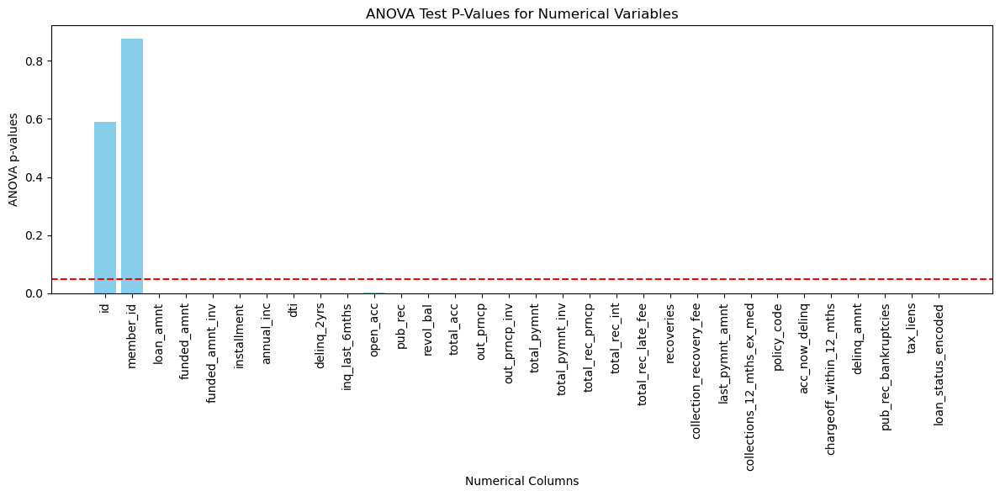

In [14]:
from scipy.stats import f_oneway
import matplotlib.pyplot as plt

# Perform ANOVA and store the results
anova_results = {}
for col in numerical_cols:
    if col != target_variable:
        groups = [group[col].values for name, group in loan_data_cleaned.groupby(target_variable)]
        f_val, p_val = f_oneway(*groups)
        anova_results[col] = p_val


columns = list(anova_results.keys())
p_values = list(anova_results.values())

# Plotting the p-values
plt.figure(figsize=(12, 6)) 
plt.bar(columns, p_values, color='skyblue')  
plt.xlabel('Numerical Columns') 
plt.ylabel('ANOVA p-values') 
plt.axhline(y=0.05, color='red', linestyle='--')  
plt.xticks(rotation=90)  
plt.title('ANOVA Test P-Values for Numerical Variables')  
plt.tight_layout()  
plt.show()  

4. **Multivariate Analysis**:
   

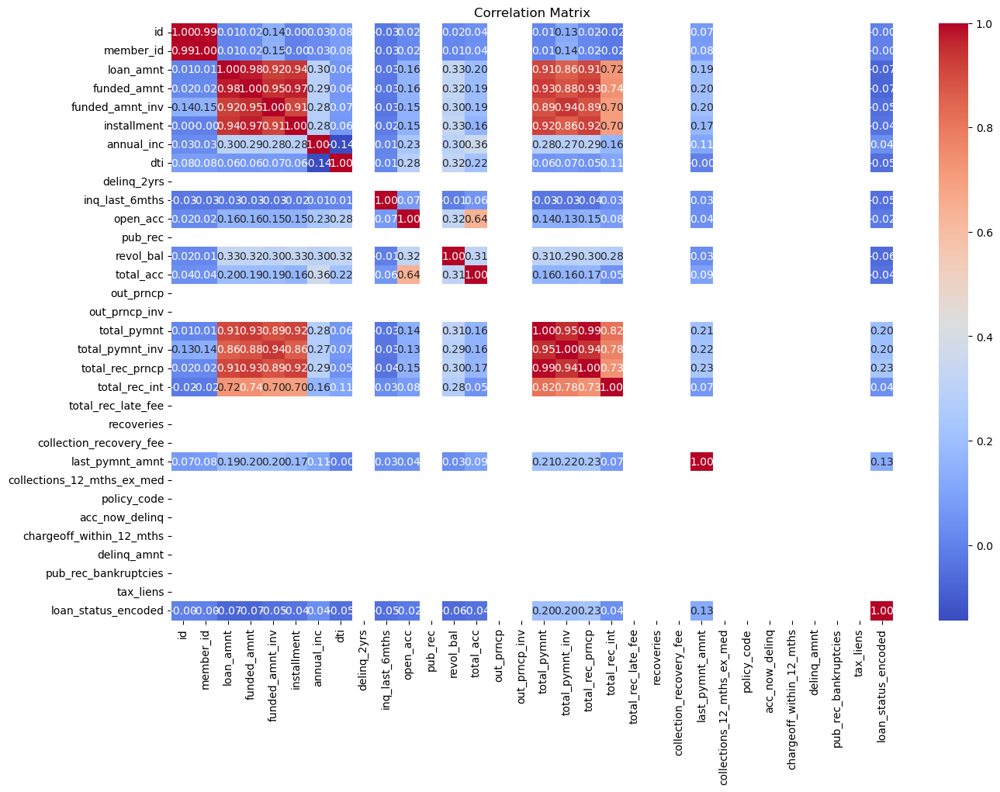

In [ ]:
plt.figure(figsize=(15, 10))
correlation_matrix = loan_data_cleaned[numerical_cols].corr()
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Correlation Matrix')
plt.show()


In [ ]:
sns.pairplot(loan_data_cleaned[numerical_cols])
plt.suptitle('Scatter Plot Matrix', y=1.02)
plt.show()


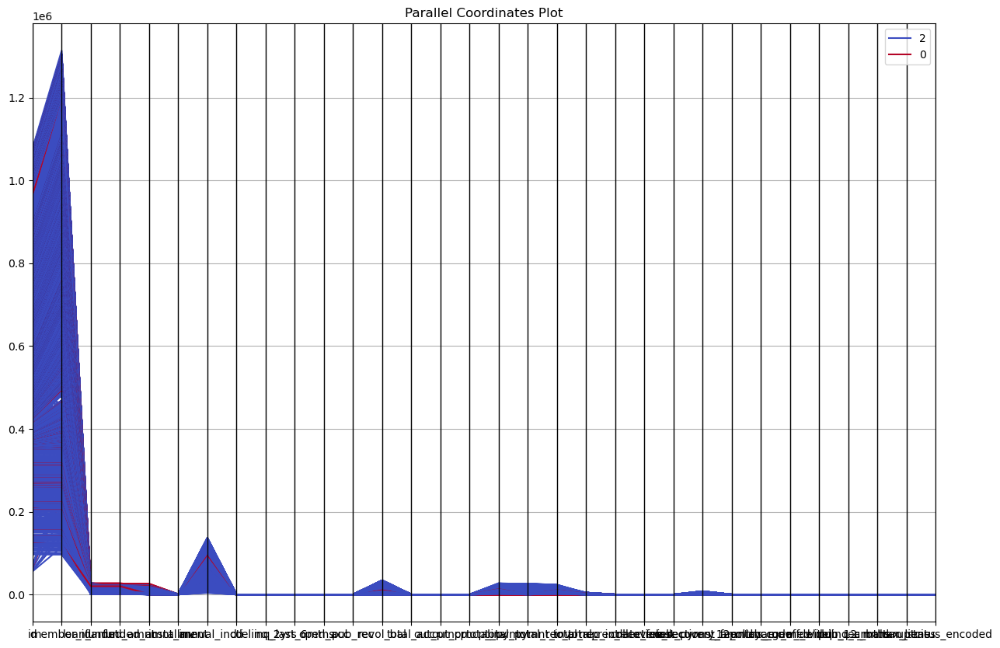

In [ ]:
from pandas.plotting import parallel_coordinates

# Assume 'loan_status' is the target variable and convert it to a string type for plotting
loan_data_cleaned['loan_status'] = loan_data_cleaned['loan_status'].astype(str)
plt.figure(figsize=(15, 10))


parallel_coordinates(loan_data_cleaned[numerical_cols + ['loan_status']], class_column='loan_status', colormap='coolwarm')
plt.title('Parallel Coordinates Plot')
plt.show()


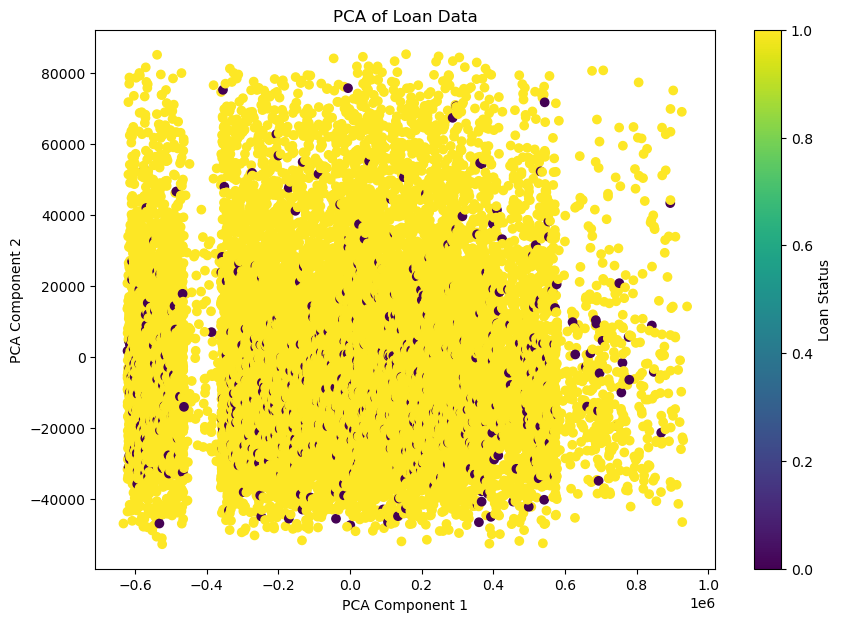

In [ ]:
from sklearn.decomposition import PCA

pca = PCA(n_components=2)
pca_components = pca.fit_transform(loan_data_cleaned[numerical_cols])

plt.figure(figsize=(10, 7))
plt.scatter(pca_components[:, 0], pca_components[:, 1], c=loan_data_cleaned['loan_status'].astype('category').cat.codes, cmap='viridis')
plt.colorbar(label='Loan Status')
plt.xlabel('PCA Component 1')
plt.ylabel('PCA Component 2')
plt.title('PCA of Loan Data')
plt.show()


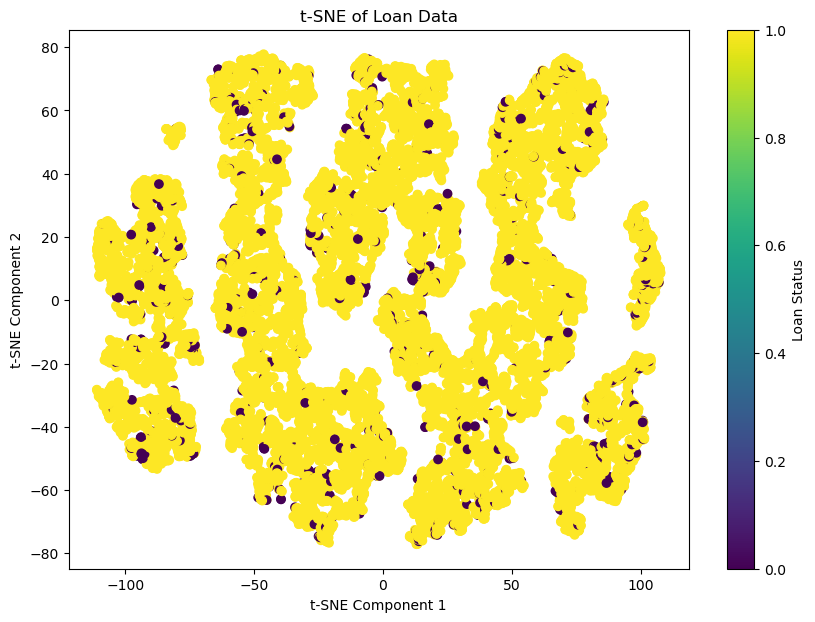

In [ ]:
from sklearn.manifold import TSNE

tsne = TSNE(n_components=2, random_state=42)
tsne_components = tsne.fit_transform(loan_data_cleaned[numerical_cols])

plt.figure(figsize=(10, 7))
plt.scatter(tsne_components[:, 0], tsne_components[:, 1], c=loan_data_cleaned['loan_status'].astype('category').cat.codes, cmap='viridis')
plt.colorbar(label='Loan Status')
plt.xlabel('t-SNE Component 1')
plt.ylabel('t-SNE Component 2')
plt.title('t-SNE of Loan Data')
plt.show()


5. **Feature Selection and Importance**:

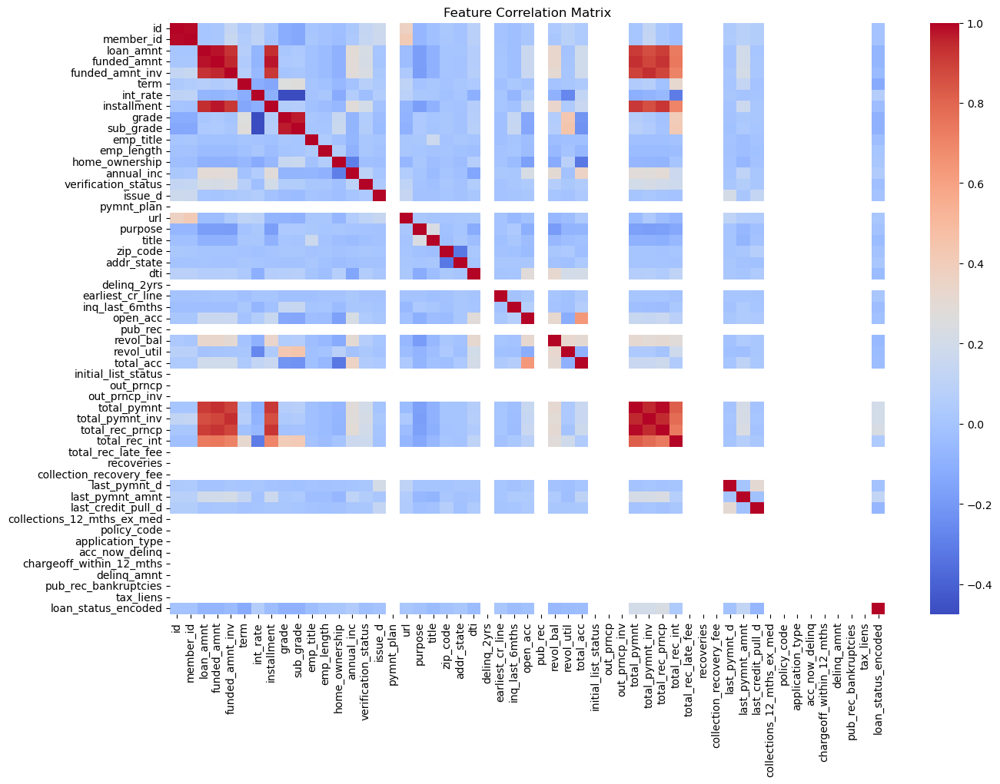

In [ ]:
# Import train_test_split from sklearn.model_selection
from sklearn.model_selection import train_test_split

# Assuming 'loan_status' is the target variable
target_variable = 'loan_status'

# Convert the target variable to numerical if it's categorical
if loan_data_cleaned[target_variable].dtype == 'object':
    loan_data_cleaned[target_variable] = loan_data_cleaned[target_variable].astype('category').cat.codes

# Separate features and target
X = loan_data_cleaned.drop(columns=[target_variable])
y = loan_data_cleaned[target_variable]

# Split the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# 1. Correlation Analysis
import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize=(15, 10))
correlation_matrix = X_train.corr()
sns.heatmap(correlation_matrix, annot=False, cmap='coolwarm')
plt.title('Feature Correlation Matrix')
plt.show()

In [ ]:
# Import RandomForestClassifier from sklearn.ensemble
from sklearn.ensemble import RandomForestClassifier
# Import RFE from sklearn.feature_selection
from sklearn.feature_selection import RFE

# 2. Recursive Feature Elimination (RFE)
model = RandomForestClassifier(random_state=42)
rfe = RFE(model, n_features_to_select=10)
fit = rfe.fit(X_train, y_train)

# Summarize the selection of the attributes
selected_features_rfe = X_train.columns[fit.support_]
print("Selected features by RFE:")
print(selected_features_rfe)

Selected features by RFE:
Index(['loan_amnt', 'funded_amnt', 'funded_amnt_inv', 'installment',
       'total_pymnt', 'total_pymnt_inv', 'total_rec_prncp', 'last_pymnt_amnt',
       'last_credit_pull_d', 'loan_status_encoded'],
      dtype='object')


Feature ranking:
1. feature loan_status_encoded (0.5420184319386978)
2. feature total_rec_prncp (0.14328918565187126)
3. feature total_pymnt (0.0611128272765707)
4. feature total_pymnt_inv (0.04400264207161988)
5. feature funded_amnt_inv (0.03922134973850391)
6. feature funded_amnt (0.03167284198053238)
7. feature installment (0.028271220628995272)
8. feature loan_amnt (0.017190488216206678)
9. feature last_pymnt_amnt (0.014261159008857337)
10. feature total_rec_int (0.010373593818696623)
11. feature last_credit_pull_d (0.008869764673704813)
12. feature id (0.006097706004262611)
13. feature url (0.004711598467786198)
14. feature term (0.004127774178867006)
15. feature member_id (0.004047668180288726)
16. feature last_pymnt_d (0.0034497406164249334)
17. feature revol_bal (0.0032923728813690134)
18. feature int_rate (0.003028054106879285)
19. feature annual_inc (0.0028558297297522762)
20. feature emp_title (0.002820292436181785)
21. feature dti (0.0027433274256204398)
22. feature title (

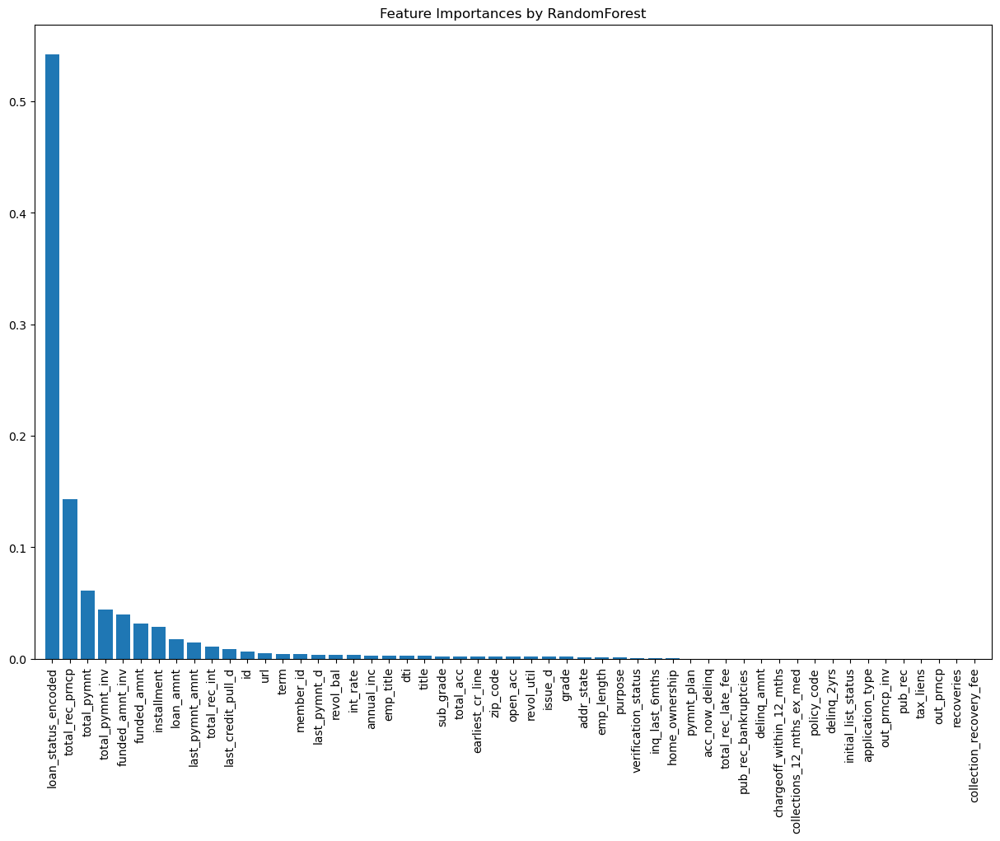

In [ ]:
# 3. Tree-based Feature Importance
model.fit(X_train, y_train)
importances = model.feature_importances_
indices = np.argsort(importances)[::-1]

# Print the feature ranking
print("Feature ranking:")
for f in range(X_train.shape[1]):
    print(f"{f + 1}. feature {X_train.columns[indices[f]]} ({importances[indices[f]]})")

# Plot the feature importances
plt.figure(figsize=(15, 10))
plt.title("Feature Importances by RandomForest")
plt.bar(range(X_train.shape[1]), importances[indices], align="center")
plt.xticks(range(X_train.shape[1]), X_train.columns[indices], rotation=90)
plt.xlim([-1, X_train.shape[1]])
plt.show()

In [ ]:
# Import accuracy_score from sklearn.metrics
from sklearn.metrics import accuracy_score

# 4. Evaluating the model performance with selected features
# Select top N features from RFE for model evaluation
N = 10
X_train_selected = X_train[selected_features_rfe[:N]]
X_test_selected = X_test[selected_features_rfe[:N]]

# Train and evaluate a model using the selected features
model_selected = RandomForestClassifier(random_state=42)
model_selected.fit(X_train_selected, y_train)
y_pred = model_selected.predict(X_test_selected)

# Calculate the accuracy
accuracy = accuracy_score(y_test, y_pred)
print(f"Accuracy with top {N} selected features: {accuracy:.4f}")

Accuracy with top 10 selected features: 1.0000
